In [ ]:
import numpy as np 
import pandas as pd 
import seaborn as sns
import matplotlib.pyplot as plt

In [ ]:
import warnings
warnings.filterwarnings("ignore")

In [ ]:
df = pd.read_csv('/content/Dataset.csv')

In [ ]:
df.head(10)

,CUST_ID,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE
0,C10001,40.900749,0.818182,95.40,0.00,95.40,0.000000,0.166667,0.000000,0.083333,0.000000,0,2,1000.0,201.802084,139.509787,0.000000,12
1,C10002,3202.467416,0.909091,0.00,0.00,0.00,6442.945483,0.000000,0.000000,0.000000,0.250000,4,0,7000.0,4103.032597,1072.340217,0.222222,12
2,C10003,2495.148862,1.000000,773.17,773.17,0.00,0.000000,1.000000,1.000000,0.000000,0.000000,0,12,7500.0,622.066742,627.284787,0.000000,12
3,C10004,1666.670542,0.636364,1499.00,1499.00,0.00,205.788017,0.083333,0.083333,0.000000,0.083333,1,1,7500.0,0.000000,NaN,0.000000,12
4,C10005,817.714335,1.000000,16.00,16.00,0.00,0.000000,0.083333,0.083333,0.000000,0.000000,0,1,1200.0,678.334763,244.791237,0.000000,12
5,C10006,1809.828751,1.000000,1333.28,0.00,1333.28,0.000000,0.666667,0.000000,0.583333,0.000000,0,8,1800.0,1400.057770,2407.246035,0.000000,12
6,C10007,627.260806,1.000000,7091.01,6402.63,688.38,0.000000,1.000000,1.000000,1.000000,0.000000,0,64,13500.0,6354.314328,198.065894,1.000000,12
7,C10008,1823.652743,1.000000,436.20,0.00,436.20,0.000000,1.000000,0.000000,1.000000,0.000000,0,12,2300.0,679.065082,532.033990,0.000000,12
8,C10009,1014.926473,1.000000,861.49,661.49,200.00,0.000000,0.333333,0.083333,0.250000,0.000000,0,5,7000.0,688.278568,311.963409,0.000000,12
9,C10010,152.225975,0.545455,1281.60,1281.60,0.00,0.000000,0.166667,0.166667,0.000000,0.000000,0,3,11000.0,1164.770591,100.302262,0.000000,12


In [ ]:
df.shape

(8950, 18)

In [ ]:
from pandas_profiling import ProfileReport

ProfileReport(df).to_notebook_iframe()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [9]:
from pandas_profiling import ProfileReport

profile = ProfileReport(df, title="Pandas Profiling Report")
profile.to_file("report.html")

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

In [10]:
df.drop(columns=['CUST_ID', 'TENURE'], inplace=True)

In [11]:
df.isnull().sum().sort_values(ascending=False)

MINIMUM_PAYMENTS                    313
CREDIT_LIMIT                          1
BALANCE                               0
BALANCE_FREQUENCY                     0
PURCHASES                             0
ONEOFF_PURCHASES                      0
INSTALLMENTS_PURCHASES                0
CASH_ADVANCE                          0
PURCHASES_FREQUENCY                   0
ONEOFF_PURCHASES_FREQUENCY            0
PURCHASES_INSTALLMENTS_FREQUENCY      0
CASH_ADVANCE_FREQUENCY                0
CASH_ADVANCE_TRX                      0
PURCHASES_TRX                         0
PAYMENTS                              0
PRC_FULL_PAYMENT                      0
dtype: int64

In [12]:
from sklearn.impute import KNNImputer

null_columns = df.columns[df.isnull().any()].tolist()
imputer = KNNImputer(n_neighbors=5)
df_imp = pd.DataFrame(imputer.fit_transform(df[null_columns]), columns=null_columns)
df = df.fillna(df_imp)

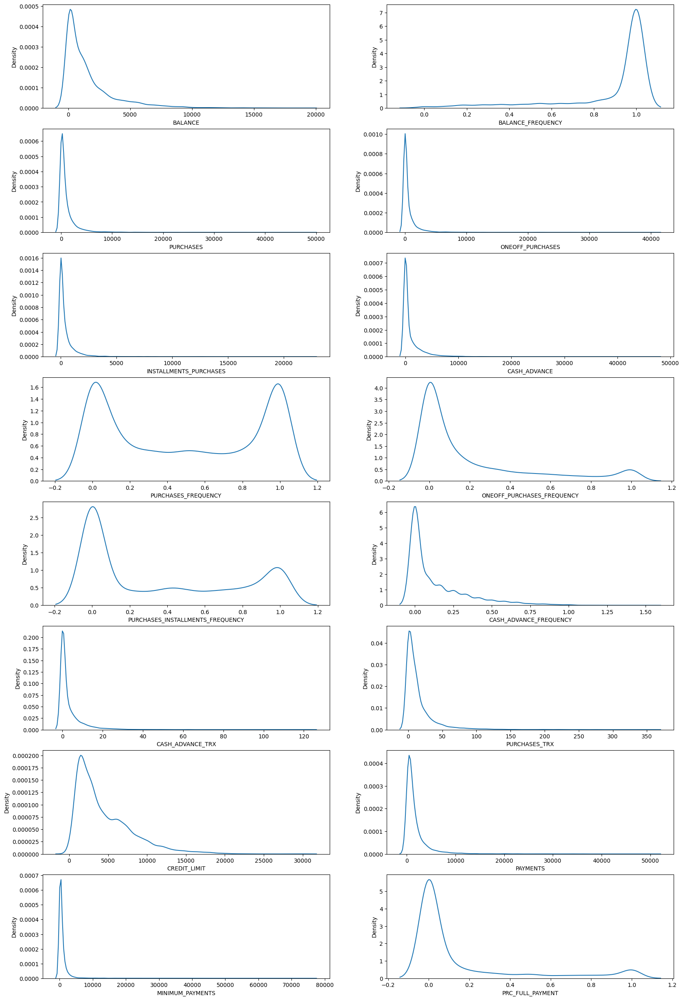

In [13]:
plt.figure(figsize=(20,35))

for i, col in enumerate(df.columns):
    ax = plt.subplot(9, 2, i+1)
    sns.kdeplot(df[col], ax=ax)
    plt.xlabel(col)
        
plt.show()

In [14]:
from sklearn.preprocessing import Normalizer
scaler = Normalizer(norm='l2')

In [15]:
from sklearn.decomposition import PCA
pca = PCA(n_components=2, random_state=1234)

In [18]:
from sklearn.pipeline import Pipeline
pipe_normalizedscaled_pca = Pipeline([('scaling', scaler), ('pca', pca)])

In [19]:
pd.DataFrame(
    pipe_normalizedscaled_pca.fit_transform(df),
    columns=['x', 'y']
)

,x,y
0,-0.316400,-0.046395
1,0.314967,-0.155121
2,-0.208100,-0.183545
3,-0.254926,-0.122050
4,0.138963,-0.089762
...,...,...
8945,-0.292587,0.164305
8946,0.302493,0.070257
8947,-0.387863,-0.062869
8948,-0.331528,-0.181578


In [23]:
from sklearn.cluster import KMeans
import plotly.express as px
import seaborn as sns

# Function
def Visualize_Cluster(df, pipeline, n_clusters):
     data = pd.DataFrame(pipeline.fit_transform(df), columns=['x', 'y'])
    
     kmeans = KMeans(n_clusters=n_clusters, n_init=10, max_iter=300, verbose=False, random_state=1234)
     clusters = pd.DataFrame(kmeans.fit_predict(data), columns=['Cluster']) 
    
     clusters_data = pd.concat([data, clusters], axis=1)
    
     fig = px.scatter(clusters_data, x='x', y='y', color='Cluster')
     fig.show()

In [24]:
Visualize_Cluster(df, pipe_normalizedscaled_pca, n_clusters=5)

In [25]:
Visualize_Cluster(df, pipe_normalizedscaled_pca, n_clusters=10)

In [26]:
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import Normalizer
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score, davies_bouldin_score, calinski_harabasz_score

pipe_normalizer = Pipeline([('normalization', Normalizer())])

In [28]:
data = pipe_normalizer.fit_transform(df)
data = pd.DataFrame(data, columns=df.columns)

def cluster_algorithm(n_clusters, dataset):
    kmean = KMeans(n_clusters=n_clusters, random_state=1234)
    labels = kmean.fit_predict(dataset)
    
    si = silhouette_score(dataset, labels, metric='euclidean', random_state=1234)
    db = davies_bouldin_score(dataset, labels)
    ch = calinski_harabasz_score(dataset, labels)
    
    return si, db, ch


n_clusters, si_list, db_list, ch_list = list(), list(), list(), list()

for i in range(2, 101):
    si, db, ch = cluster_algorithm(i, data)
    n_clusters.append(int(i))
    si_list.append(si)
    db_list.append(db)
    ch_list.append(ch)

metrics = pd.DataFrame(np.column_stack((n_clusters, si_list, db_list, ch_list)), columns=['N° Clusters', 'silhouette', 'davies_bouldin', 'calinski_harabasz'])

In [29]:
import plotly.express as px
# Silhouette
fig = px.line(metrics, x='N° Clusters', y='silhouette', title='Silhouette')
fig.show()

In [30]:
fig = px.line(metrics, x='N° Clusters', y='davies_bouldin', title='Davies Bouldin')
fig.show()

In [31]:
fig = px.line(metrics, x='N° Clusters', y='calinski_harabasz', title='Calinski Harabasz')
fig.show()

In [32]:
metrics[metrics['N° Clusters'] <= 8][['N° Clusters', 'silhouette']].sort_values(by='silhouette', ascending=False)

metrics[metrics['N° Clusters'] <= 8][['N° Clusters', 'davies_bouldin']].sort_values(by='davies_bouldin', ascending=True)

metrics[metrics['N° Clusters'] <= 8][['N° Clusters', 'calinski_harabasz']].sort_values(by='calinski_harabasz', ascending=False)

# n_cluster = 5
metrics[metrics['N° Clusters'] == 5].reset_index(drop=True)

,N° Clusters,silhouette,davies_bouldin,calinski_harabasz
0,5.0,0.354871,1.104302,3420.187025


In [33]:
dataset = np.random.rand(8950, 16)

si, db, ch = cluster_algorithm(5, dataset)

pd.DataFrame(data=[[5, si, db, ch]], columns=['N° Clusters', 'silhouette', 'davies_bouldin', 'calinsk_harabasz'])

,N° Clusters,silhouette,davies_bouldin,calinsk_harabasz
0,5,0.039543,3.506995,303.689402


In [34]:
print('Metrics of the cluster with a normal dataset:')
display(metrics[metrics['N° Clusters'] == 5].reset_index(drop=True))
print('Metrics of the cluster with a random dataset:')
display(pd.DataFrame(data=[[5, si, db, ch]], columns=['N° Clusters', 'silhouette', 'davies_bouldin', 'calinsk_harabasz']))

Metrics of the cluster with a normal dataset:


,N° Clusters,silhouette,davies_bouldin,calinski_harabasz
0,5.0,0.354871,1.104302,3420.187025


Metrics of the cluster with a random dataset:


,N° Clusters,silhouette,davies_bouldin,calinsk_harabasz
0,5,0.039543,3.506995,303.689402


In [35]:
splited_df = np.array_split(df, 5)

section, si_list, db_list, ch_list = list(), list(), list(), list()

for i in range(5):
    si, sb, ch = cluster_algorithm(5, splited_df[i])
    section.append(i+1)
    si_list.append(si)
    db_list.append(sb)
    ch_list.append(ch)


pd.DataFrame(np.column_stack([section, si_list, db_list, ch_list]), columns=['Section N°', 'silhouette', 'davies_bouldin', 'calinski_harabasz'])

,Section N°,silhouette,davies_bouldin,calinski_harabasz
0,1.0,0.349179,1.255835,649.387961
1,2.0,0.358392,1.209668,552.640213
2,3.0,0.347279,1.242337,550.807550
3,4.0,0.357405,1.191231,566.570221
4,5.0,0.540296,1.142280,515.106314


In [36]:
kmeans = KMeans(n_clusters=5, n_init=10, max_iter=300, verbose=False, random_state=1234)
labels = pd.DataFrame(kmeans.fit_predict(data), columns=['CLUSTER']) 
    
clusters_data = pd.concat([df, labels], axis=1)
clusters_data

,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,CLUSTER
0,40.900749,0.818182,95.40,0.00,95.40,0.000000,0.166667,0.000000,0.083333,0.000000,0,2,1000.0,201.802084,139.509787,0.000000,2
1,3202.467416,0.909091,0.00,0.00,0.00,6442.945483,0.000000,0.000000,0.000000,0.250000,4,0,7000.0,4103.032597,1072.340217,0.222222,1
2,2495.148862,1.000000,773.17,773.17,0.00,0.000000,1.000000,1.000000,0.000000,0.000000,0,12,7500.0,622.066742,627.284787,0.000000,2
3,1666.670542,0.636364,1499.00,1499.00,0.00,205.788017,0.083333,0.083333,0.000000,0.083333,1,1,7500.0,0.000000,1215.951453,0.000000,2
4,817.714335,1.000000,16.00,16.00,0.00,0.000000,0.083333,0.083333,0.000000,0.000000,0,1,1200.0,678.334763,244.791237,0.000000,3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8945,28.493517,1.000000,291.12,0.00,291.12,0.000000,1.000000,0.000000,0.833333,0.000000,0,6,1000.0,325.594462,48.886365,0.500000,2
8946,19.183215,1.000000,300.00,0.00,300.00,0.000000,1.000000,0.000000,0.833333,0.000000,0,6,1000.0,275.861322,3720.379789,0.000000,4
8947,23.398673,0.833333,144.40,0.00,144.40,0.000000,0.833333,0.000000,0.666667,0.000000,0,5,1000.0,81.270775,82.418369,0.250000,2
8948,13.457564,0.833333,0.00,0.00,0.00,36.558778,0.000000,0.000000,0.000000,0.166667,2,0,500.0,52.549959,55.755628,0.250000,2


In [37]:
clusters_data['CLUSTER'].value_counts()

2    3241
3    2102
0    1644
1    1600
4     363
Name: CLUSTER, dtype: int64

In [38]:
fig = px.scatter(clusters_data, x='PURCHASES', y='PAYMENTS', color='CLUSTER')
fig.show()

In [39]:
fig = px.scatter(clusters_data, x='PURCHASES', y='CASH_ADVANCE', color='CLUSTER')
fig.show()

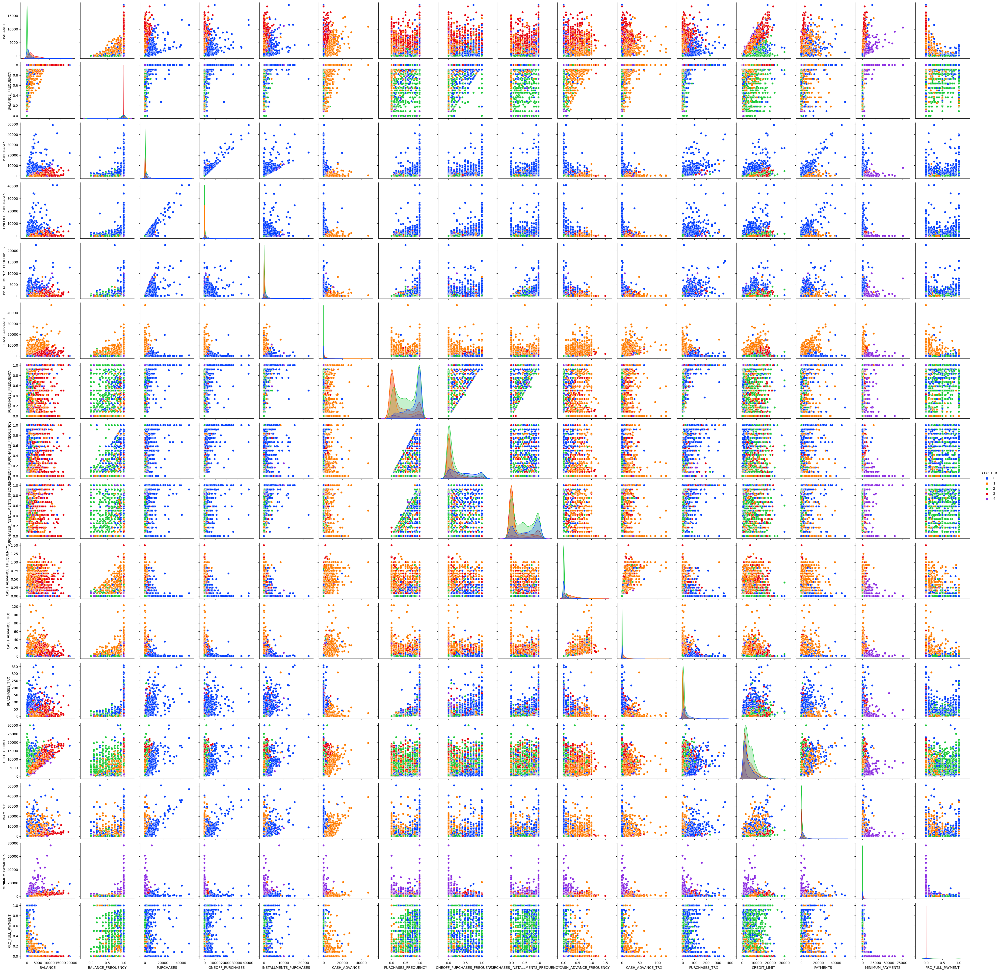

In [40]:
sns.pairplot(clusters_data, hue='CLUSTER', palette='bright')

In [41]:
clusters_data.groupby(by='CLUSTER').describe()

BALANCE                                                     \
          count         mean          std         min          25%   
CLUSTER                                                              
0        1644.0  1126.550442  1641.768094    0.000000   211.566656   
1        1600.0  1990.480586  1955.469710    0.074724   665.445823   
2        3241.0   441.448287   814.551573    0.000000    24.680177   
3        2102.0  3284.571075  2581.157698  114.523682  1377.273528   
4         363.0  1736.445029  1790.535310    0.000000   775.039403   

                                                BALANCE_FREQUENCY            \
                 50%          75%           max             count      mean   
CLUSTER                                                                       
0         556.818403  1337.243792  19043.138560            1644.0  0.913674   
1        1327.081747  2655.041636  14581.459140            1600.0  0.870339   
2          84.988845   424.968492   7533.854422            3241.0  0.781606   
3        2435.613264  4566.671013  18495.558550            2102.0  0.997674   
4        1227.548135  1988.949826  11209.370760             363.0  0.899876   

         ... MINIMUM_PAYMENTS               PRC_FULL_PAYMENT            \
         ...              75%           max            count      mean   
CLUSTER  ...                                                             
0        ...       560.351224  18621.013310           1644.0  0.270345   
1        ...       931.233687  21235.065300           1600.0  0.069864   
2        ...       234.095576   3933.230932           3241.0  0.250449   
3        ...      1475.373507   9642.502512           2102.0  0.000661   
4        ...      7552.564642  76406.207520            363.0  0.017695   

                                                      
              std  min  25%       50%       75%  max  
CLUSTER                                               
0        0.361306  0.0  0.0  0.083333  0.500000  1.0  
1        0.152540  0.0  0.0  0.000000  0.083333  1.0  
2        0.347542  0.0  0.0  0.000000  0.454545  1.0  
3        0.007566  0.0  0.0  0.000000  0.000000  0.1  
4        0.084604  0.0  0.0  0.000000  0.000000  1.0  

[5 rows x 128 columns]

In [42]:
centroids = kmeans.cluster_centers_
centroids

array([[1.59548639e-01, 2.43949994e-04, 4.17932568e-01, 2.43594434e-01,
        1.74496296e-01, 3.40770502e-02, 1.97932757e-04, 8.60936021e-05,
        1.45348180e-04, 1.12340363e-05, 2.14345253e-04, 5.93357135e-03,
        5.88615917e-01, 4.36169177e-01, 9.25661094e-02, 7.02812712e-05],
       [2.91488891e-01, 2.27288520e-04, 4.45971861e-02, 2.43327469e-02,
        2.02675061e-02, 4.94958116e-01, 4.74928886e-05, 1.63920827e-05,
        3.18695459e-05, 7.77468299e-05, 1.81872632e-03, 8.62258651e-04,
        6.02130404e-01, 3.84210816e-01, 1.17999934e-01, 1.65268252e-05],
       [6.86246386e-02, 2.30383633e-04, 1.22651109e-01, 4.90885709e-02,
        7.36653985e-02, 2.37726803e-02, 1.70681096e-04, 3.40251438e-05,
        1.38117840e-04, 7.83441260e-06, 1.23851559e-04, 2.86720718e-03,
        9.43170767e-01, 1.55164486e-01, 5.74965420e-02, 7.69938563e-05],
       [5.47726311e-01, 2.86009353e-04, 7.72543430e-02, 4.37306965e-02,
        3.35585430e-02, 1.40328747e-01, 8.08157687e-05, 3.047

In [43]:
for i in range(centroids.shape[1]):
    print(f'{clusters_data.columns[i]}:', '{:.4f}'.format(centroids[:, i].var()))

BALANCE: 0.0261
BALANCE_FREQUENCY: 0.0000
PURCHASES: 0.0179
ONEOFF_PURCHASES: 0.0070
INSTALLMENTS_PURCHASES: 0.0030
CASH_ADVANCE: 0.0315
PURCHASES_FREQUENCY: 0.0000
ONEOFF_PURCHASES_FREQUENCY: 0.0000
PURCHASES_INSTALLMENTS_FREQUENCY: 0.0000
CASH_ADVANCE_FREQUENCY: 0.0000
CASH_ADVANCE_TRX: 0.0000
PURCHASES_TRX: 0.0000
CREDIT_LIMIT: 0.0364
PAYMENTS: 0.0131
MINIMUM_PAYMENTS: 0.0680
PRC_FULL_PAYMENT: 0.0000


In [44]:
centroids_list = list()

for i in range(centroids.shape[1]):
    centroids_list.append(centroids[:, i].var())


centroids_var = pd.DataFrame(centroids_list, index=clusters_data.columns[:-1], columns=['Variance of the Centroids'])
centroids_var

,Variance of the Centroids
BALANCE,2.608722e-02
BALANCE_FREQUENCY,5.965364e-10
PURCHASES,1.789921e-02
ONEOFF_PURCHASES,7.021715e-03
INSTALLMENTS_PURCHASES,2.997621e-03
CASH_ADVANCE,3.149836e-02
PURCHASES_FREQUENCY,3.121028e-09
ONEOFF_PURCHASES_FREQUENCY,6.707697e-10
PURCHASES_INSTALLMENTS_FREQUENCY,2.172643e-09
CASH_ADVANCE_FREQUENCY,6.966036e-10


In [45]:
significant_centroids_var = centroids_var[centroids_var['Variance of the Centroids'] > 0.009]
significant_centroids_var

,Variance of the Centroids
BALANCE,0.026087
PURCHASES,0.017899
CASH_ADVANCE,0.031498
CREDIT_LIMIT,0.036371
PAYMENTS,0.013083
MINIMUM_PAYMENTS,0.067968


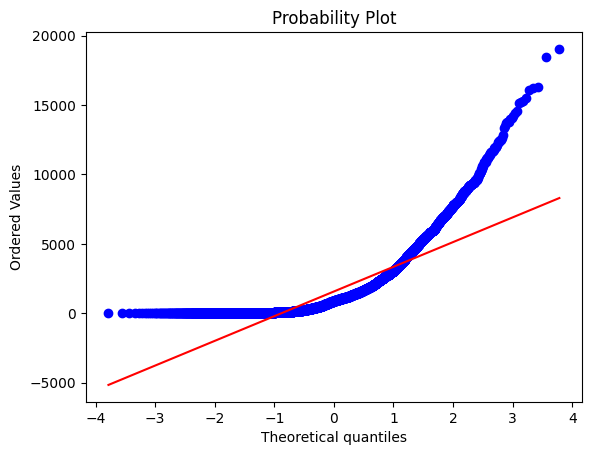

In [46]:
from scipy import stats

stats.probplot(clusters_data['BALANCE'], plot=plt)
plt.show()

In [47]:
balance = significant_centroids_var.index[0]

clusters_data[[balance, 'CLUSTER']].groupby(by='CLUSTER').describe()

BALANCE                                                     \
          count         mean          std         min          25%   
CLUSTER                                                              
0        1644.0  1126.550442  1641.768094    0.000000   211.566656   
1        1600.0  1990.480586  1955.469710    0.074724   665.445823   
2        3241.0   441.448287   814.551573    0.000000    24.680177   
3        2102.0  3284.571075  2581.157698  114.523682  1377.273528   
4         363.0  1736.445029  1790.535310    0.000000   775.039403   

                                                 
                 50%          75%           max  
CLUSTER                                          
0         556.818403  1337.243792  19043.138560  
1        1327.081747  2655.041636  14581.459140  
2          84.988845   424.968492   7533.854422  
3        2435.613264  4566.671013  18495.558550  
4        1227.548135  1988.949826  11209.370760

In [48]:
purchases = significant_centroids_var.index[1]

clusters_data[[purchases, 'CLUSTER']].groupby(by='CLUSTER').describe()

PURCHASES                                                    \
            count         mean          std  min      25%       50%   
CLUSTER                                                               
0          1644.0  3120.102968  4033.939253  0.0  1038.54  1955.030   
1          1600.0   308.187431   718.684827  0.0     0.00     0.000   
2          3241.0   641.798963   774.248143  0.0   133.45   369.490   
3          2102.0   486.163911   904.865857  0.0     0.00   124.825   
4           363.0   700.129780  1140.646396  0.0    58.50   360.000   

                              
               75%       max  
CLUSTER                       
0        3680.6875  49039.57  
1         333.0000  11500.94  
2         849.5700   6407.67  
3         554.5125   7823.74  
4         861.7300  11147.33

In [49]:
cash_advance = significant_centroids_var.index[2]

clusters_data[[cash_advance, 'CLUSTER']].groupby(by='CLUSTER').describe()

CASH_ADVANCE                                                    \
               count         mean          std        min          25%   
CLUSTER                                                                  
0             1644.0   250.441126   907.730891   0.000000     0.000000   
1             1600.0  3470.459550  3493.335407  18.042768  1287.904845   
2             3241.0   144.761376   505.387667   0.000000     0.000000   
3             2102.0  1037.202795  1405.091885   0.000000    18.143704   
4              363.0   405.135180   953.842062   0.000000     0.000000   

                                                 
                 50%          75%           max  
CLUSTER                                          
0           0.000000     0.000000  19513.474830  
1        2408.249053  4407.849177  47137.211760  
2           0.000000     0.000000   6523.780195  
3         382.590491  1605.122237   9236.092963  
4           0.000000   370.417727  10616.270140

In [50]:
credit_limit = significant_centroids_var.index[3]

clusters_data[[credit_limit, 'CLUSTER']].groupby(by='CLUSTER').describe()

CREDIT_LIMIT                                                           \
               count         mean          std    min     25%     50%     75%   
CLUSTER                                                                         
0             1644.0  4009.289089  3677.284097  150.0  1500.0  2600.0  5500.0   
1             1600.0  4025.950758  3244.995775   50.0  1500.0  3000.0  6000.0   
2             3241.0  5183.812298  3679.395758  300.0  2500.0  4000.0  7000.0   
3             2102.0  4578.211227  3780.553593  300.0  1600.0  3000.0  6500.0   
4              363.0  2112.947658  1808.420411  150.0  1000.0  1500.0  2500.0   

                  
             max  
CLUSTER           
0        30000.0  
1        19600.0  
2        30000.0  
3        22000.0  
4        11000.0

In [51]:
payments = significant_centroids_var.index[4]

clusters_data[[payments, 'CLUSTER']].groupby(by='CLUSTER').describe()

PAYMENTS                                                           \
           count         mean          std  min          25%          50%   
CLUSTER                                                                     
0         1644.0  3304.691926  4481.132909  0.0  1032.450421  1954.687796   
1         1600.0  2950.189870  4032.564609  0.0   546.322977  1591.607071   
2         3241.0   828.589439   974.159476  0.0   230.605229   509.309215   
3         2102.0  1077.191697   998.255648  0.0   451.079707   756.606016   
4          363.0  1125.908640  1412.013564  0.0   213.167907   632.227172   

                                    
                 75%           max  
CLUSTER                             
0        3849.726844  50721.483360  
1        3616.401849  39048.597620  
2        1065.255264   8946.495566  
3        1380.486297  11123.409180  
4        1395.157070   8735.607835

In [52]:
clusters_data[['PRC_FULL_PAYMENT', 'CLUSTER']].groupby(by='CLUSTER').describe()

PRC_FULL_PAYMENT                                                    \
                   count      mean       std  min  25%       50%       75%   
CLUSTER                                                                      
0                 1644.0  0.270345  0.361306  0.0  0.0  0.083333  0.500000   
1                 1600.0  0.069864  0.152540  0.0  0.0  0.000000  0.083333   
2                 3241.0  0.250449  0.347542  0.0  0.0  0.000000  0.454545   
3                 2102.0  0.000661  0.007566  0.0  0.0  0.000000  0.000000   
4                  363.0  0.017695  0.084604  0.0  0.0  0.000000  0.000000   

              
         max  
CLUSTER       
0        1.0  
1        1.0  
2        1.0  
3        0.1  
4        1.0

In [55]:
minimum_payments = significant_centroids_var.index[5]
clusters_data[[minimum_payments, 'CLUSTER']].groupby(by='CLUSTER').describe()

MINIMUM_PAYMENTS                                                     \
                   count         mean          std         min          25%   
CLUSTER                                                                       
0                 1644.0   578.574226  1139.885550   13.545097   169.569285   
1                 1600.0   745.876328   989.038551    1.334075   260.244199   
2                 3241.0   242.664440   269.153780    0.019163   119.087402   
3                 2102.0  1155.614326  1009.036059  152.279898   481.277469   
4                  363.0  6652.503988  8973.981411  277.040895  1869.653747   

                                                 
                 50%          75%           max  
CLUSTER                                          
0         227.073920   560.351224  18621.013310  
1         472.904888   931.233687  21235.065300  
2         170.737760   234.095576   3933.230932  
3         852.738821  1475.373507   9642.502512  
4        3520.912186  7552.564642  76406.207520

In [56]:
clusters_data['CLUSTER'].value_counts()

2    3241
3    2102
0    1644
1    1600
4     363
Name: CLUSTER, dtype: int64